# 0. Library and intial config

In [1]:
import os
import logging
import random
import gc
import time
import cv2
import math
import warnings
from pathlib import Path

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import FastMarkerCluster
import ipywidgets as widgets

import librosa
import librosa.display
import IPython

from glob import glob
import pickle

import timm
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.utils.data import Dataset, DataLoader

from tqdm.auto import tqdm

In [2]:
class CFG:
    
    seed = 42
    debug = True  
    apex = False
    print_freq = 100
    num_workers = 2
    
    OUTPUT_DIR = '/kaggle/working/'

    train_datadir = '/kaggle/input/birdclef-2025/train_audio'
    train_csv = '/kaggle/input/birdclef-2025/train.csv'
    test_soundscapes = '/kaggle/input/birdclef-2025/test_soundscapes'
    submission_csv = '/kaggle/input/birdclef-2025/sample_submission.csv'
    taxonomy_csv = '/kaggle/input/birdclef-2025/taxonomy.csv'

    spectrogram_npy = '/kaggle/input/birdclef25-mel-spectrograms/birdclef2025_melspec_5sec_256_256.npy'
 
    model_name = 'efficientnet_b0'  
    pretrained = True
    in_channels = 1

    LOAD_DATA = True  
    FS = 32000
    TARGET_DURATION = 5.0
    TARGET_SHAPE = (256, 256)
    
    N_FFT = 1024
    HOP_LENGTH = 512
    N_MELS = 128
    FMIN = 50
    FMAX = 14000
    
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    epochs = 10  
    batch_size = 32  
    criterion = 'BCEWithLogitsLoss'

    n_fold = 5
    selected_folds = [0, 1, 2, 3, 4]   

    optimizer = 'AdamW'
    lr = 5e-4 
    weight_decay = 1e-5
  
    scheduler = 'CosineAnnealingLR'
    min_lr = 1e-6
    T_max = epochs

    aug_prob = 0.5  
    mixup_alpha = 0.5  
    
    def update_debug_settings(self):
        if self.debug:
            self.epochs = 2
            self.selected_folds = [0]

cfg = CFG()

# 1. EDA

## 1.1 Basic Analysis

In [3]:
def explore_dataset(dataset_path, max_depth=2):
    print(f"Exploring dataset at: {dataset_path}\n")
    
    # Duyệt qua tất cả thư mục và file bằng os.walk
    for root, dirs, files in os.walk(dataset_path):
        # Tính cấp độ hiện tại bằng cách đếm số phân tách trong đường dẫn
        level = root.replace(dataset_path, '').count(os.sep) + 1
        
        # Thoát nếu vượt quá cấp độ mong muốn
        if level > max_depth:
            continue
            
        # Đếm số thư mục con và file trong thư mục hiện tại
        num_dirs = len(dirs)
        num_files = len(files)
        
        # In thông tin
        print(f"Thư mục: {root}")
        print(f"  Số thư mục con: {num_dirs}")
        print(f"  Số file: {num_files}")
        print("-" * 50)

# explore_dataset('/kaggle/input/birdclef-2025')

### Nhận xét
- Trong train audio có âm thanh của 206 class cần phân loại.
- Trong test soundscapes chỉ có 1 file README thông báo nơi bộ test được cung cấp.
- Trong train soundscapes có 9726 file ogg, là tập dữ liệu đã được chia sẵn để huấn luyện.
    - Vị trí ghi âm + ngày tháng  + thời điểm = tên file 

In [4]:
# Load thử file train.csv

df_train = pd.read_csv('/kaggle/input/birdclef-2025/train.csv')
df_train.head(5)

,primary_label,secondary_labels,type,filename,collection,rating,url,latitude,longitude,scientific_name,common_name,author,license
0,1139490,[''],[''],1139490/CSA36385.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3206,-73.7128,Ragoniella pulchella,Ragoniella pulchella,Fabio A. Sarria-S,cc-by-nc-sa 4.0
1,1139490,[''],[''],1139490/CSA36389.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3206,-73.7128,Ragoniella pulchella,Ragoniella pulchella,Fabio A. Sarria-S,cc-by-nc-sa 4.0
2,1192948,[''],[''],1192948/CSA36358.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0
3,1192948,[''],[''],1192948/CSA36366.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.2800,-73.8582,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0
4,1192948,[''],[''],1192948/CSA36373.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0


### Filename ánh xạ tới tập train_audio

In [5]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28564 entries, 0 to 28563
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   primary_label     28564 non-null  object 
 1   secondary_labels  28564 non-null  object 
 2   type              28564 non-null  object 
 3   filename          28564 non-null  object 
 4   collection        28564 non-null  object 
 5   rating            28564 non-null  float64
 6   url               28564 non-null  object 
 7   latitude          27755 non-null  float64
 8   longitude         27755 non-null  float64
 9   scientific_name   28564 non-null  object 
 10  common_name       28564 non-null  object 
 11  author            28564 non-null  object 
 12  license           28564 non-null  object 
dtypes: float64(3), object(10)
memory usage: 2.8+ MB


### Nhận xét
Dữ liệu thiếu ở kinh độ và vĩ độ, nguyên nhân là ?

Tại sao lại có tới 28564 hàng ? nó tương ứng với điều gì ?

Một số thông tin có thể không cần thiết cho bài toán: author, license, url

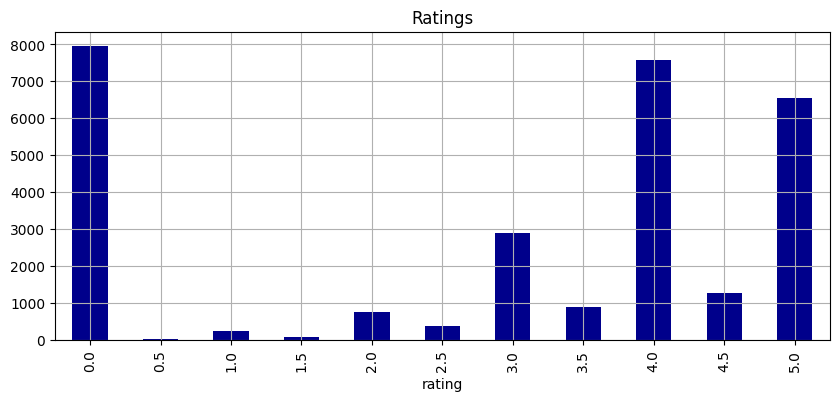

In [6]:
df_train['rating'].value_counts()

plt.figure(figsize=(10,4))
df_train['rating'].value_counts().sort_index().plot(kind='bar', color='darkblue')
plt.title('Ratings')
plt.grid()
plt.show()

In [7]:
df_train['collection'].value_counts()

collection
XC      21204
iNat     7198
CSA       162
Name: count, dtype: int64

### Nhận xét
Phần lớn dữ liệu là lấy từ xeno-canto, do CSA và iNaturalist không cung cấp rating

In [8]:
df_train['primary_label'].value_counts()

primary_label
grekis     990
compau     808
trokin     787
roahaw     709
banana     610
          ... 
476537       2
47067        2
42113        2
42087        2
1139490      2
Name: count, Length: 206, dtype: int64

In [9]:
df_taxonomy = pd.read_csv('/kaggle/input/birdclef-2025/taxonomy.csv')
df_taxonomy.head(5)

,primary_label,inat_taxon_id,scientific_name,common_name,class_name
0,1139490,1139490,Ragoniella pulchella,Ragoniella pulchella,Insecta
1,1192948,1192948,Oxyprora surinamensis,Oxyprora surinamensis,Insecta
2,1194042,1194042,Copiphora colombiae,Copiphora colombiae,Insecta
3,126247,126247,Leptodactylus insularum,Spotted Foam-nest Frog,Amphibia
4,1346504,1346504,Neoconocephalus brachypterus,Neoconocephalus brachypterus,Insecta


In [10]:
df_taxonomy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 206 entries, 0 to 205
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   primary_label    206 non-null    object
 1   inat_taxon_id    206 non-null    int64 
 2   scientific_name  206 non-null    object
 3   common_name      206 non-null    object
 4   class_name       206 non-null    object
dtypes: int64(1), object(4)
memory usage: 8.2+ KB


In [11]:
df_taxonomy[df_taxonomy['primary_label'].astype(str) != df_taxonomy['inat_taxon_id'].astype(str)]

,primary_label,inat_taxon_id,scientific_name,common_name,class_name
60,amakin1,2679,Chloroceryle amazona,Amazon Kingfisher,Aves
61,amekes,4665,Falco sparverius,American Kestrel,Aves
62,ampkin1,2676,Chloroceryle aenea,American Pygmy Kingfisher,Aves
63,anhing,5063,Anhinga anhinga,Anhinga,Aves
64,babwar,145236,Setophaga castanea,Bay-breasted Warbler,Aves
...,...,...,...,...,...
201,yehcar1,1432779,Milvago chimachima,Yellow-headed Caracara,Aves
202,yelori1,9352,Icterus nigrogularis,Yellow Oriole,Aves
203,yeofly1,16567,Tolmomyias sulphurescens,Yellow-olive Flycatcher,Aves
204,yercac1,10359,Cacicus cela,Yellow-rumped Cacique,Aves


In [12]:
df_taxonomy['class_name'].value_counts()

class_name
Aves        146
Amphibia     34
Insecta      17
Mammalia      9
Name: count, dtype: int64

### Nhận xét
- ```primary_label``` là mã định danh loài, và mã này là **str** nếu như loài đó là Chim, còn không thì mã của chúng tương ứng với ```inat_taxon_id```
- Quá nửa là chim (146 / 206), số lượng động vật có vú thấp (9 / 206). => Bài toán phân loại class bị thiên lệch

In [13]:
## Quay về kiểm tra số lượng chim có trong tập train
df_train['primary_label'] = df_train['primary_label'].astype(str)

# Đếm số lượng primary_label là số (chuỗi biểu diễn số)
is_numeric = df_train['primary_label'].str.isnumeric()
numeric_count = is_numeric.sum()

# Đếm số lượng primary_label là chữ (chuỗi không phải số)
non_numeric_count = len(df_train) - numeric_count

# In kết quả
print(f"\nSố lượng primary_label là số: {numeric_count}")
print(f"Số lượng primary_label là chữ: {non_numeric_count}")


Số lượng primary_label là số: 916
Số lượng primary_label là chữ: 27648


### Nhận xét
- Toàn chim, bảo sao là BirdCLEF

## 1.2 Geography plot

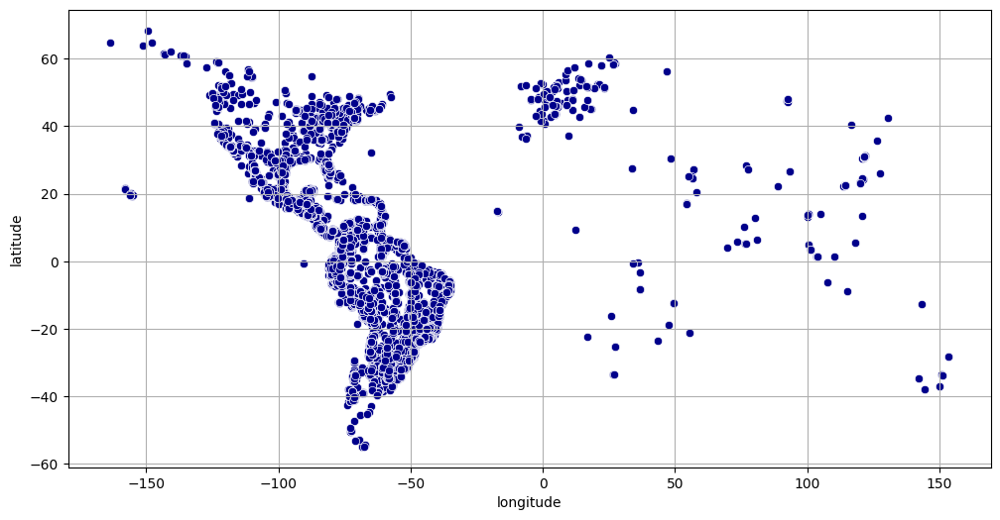

In [14]:
plt.figure(figsize=(12,6))
sns.scatterplot(data=df_train, x='longitude', y='latitude', 
                color='darkblue')
plt.grid()
plt.show()

### PLot follow class

In [15]:
df = pd.merge(left=df_train, right=df_taxonomy[['primary_label', 'inat_taxon_id', 'class_name']], how='left', on='primary_label')

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28564 entries, 0 to 28563
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   primary_label     28564 non-null  object 
 1   secondary_labels  28564 non-null  object 
 2   type              28564 non-null  object 
 3   filename          28564 non-null  object 
 4   collection        28564 non-null  object 
 5   rating            28564 non-null  float64
 6   url               28564 non-null  object 
 7   latitude          27755 non-null  float64
 8   longitude         27755 non-null  float64
 9   scientific_name   28564 non-null  object 
 10  common_name       28564 non-null  object 
 11  author            28564 non-null  object 
 12  license           28564 non-null  object 
 13  inat_taxon_id     28564 non-null  int64  
 14  class_name        28564 non-null  object 
dtypes: float64(3), int64(1), object(11)
memory usage: 3.3+ MB


In [16]:
df.latitude = pd.to_numeric(df.latitude.replace(to_replace='None', value=np.nan), errors='coerce')
df.longitude = pd.to_numeric(df.longitude.replace(to_replace='None', value=np.nan), errors='coerce')

In [17]:
species = df_taxonomy['class_name'].unique()
species

array(['Insecta', 'Amphibia', 'Mammalia', 'Aves'], dtype=object)

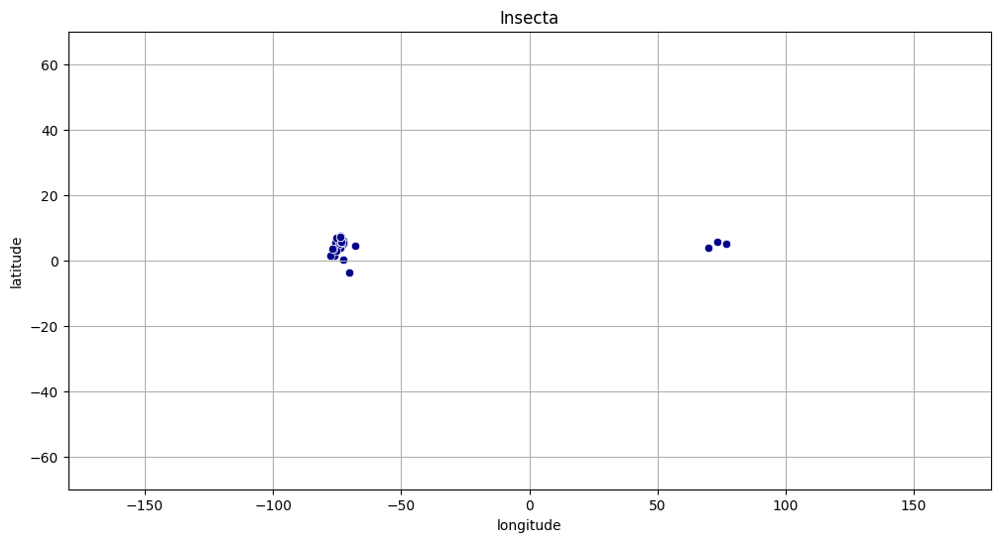

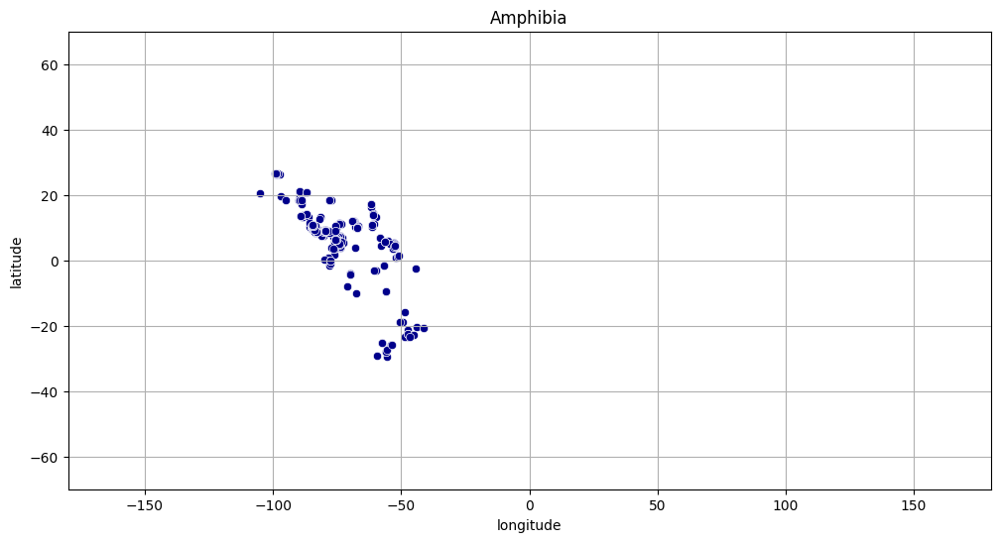

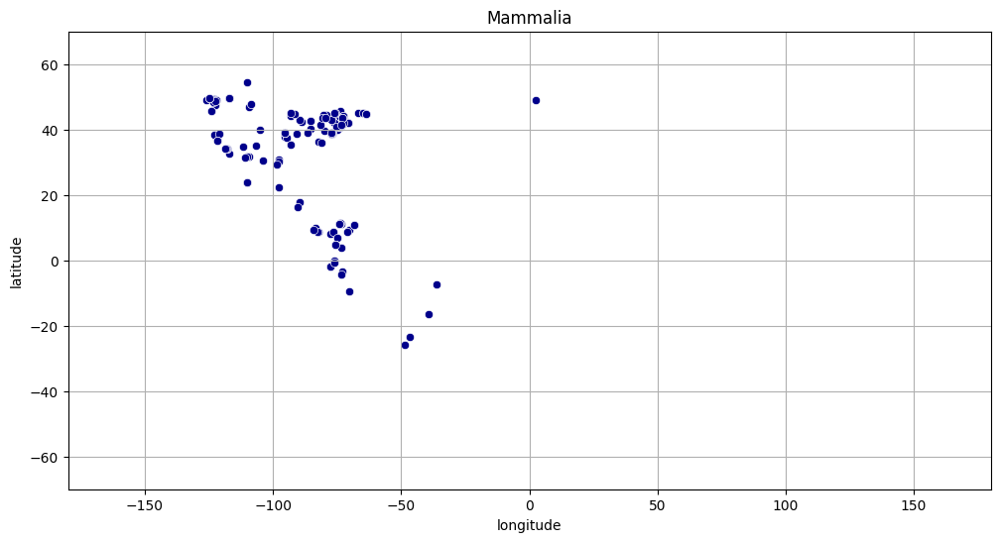

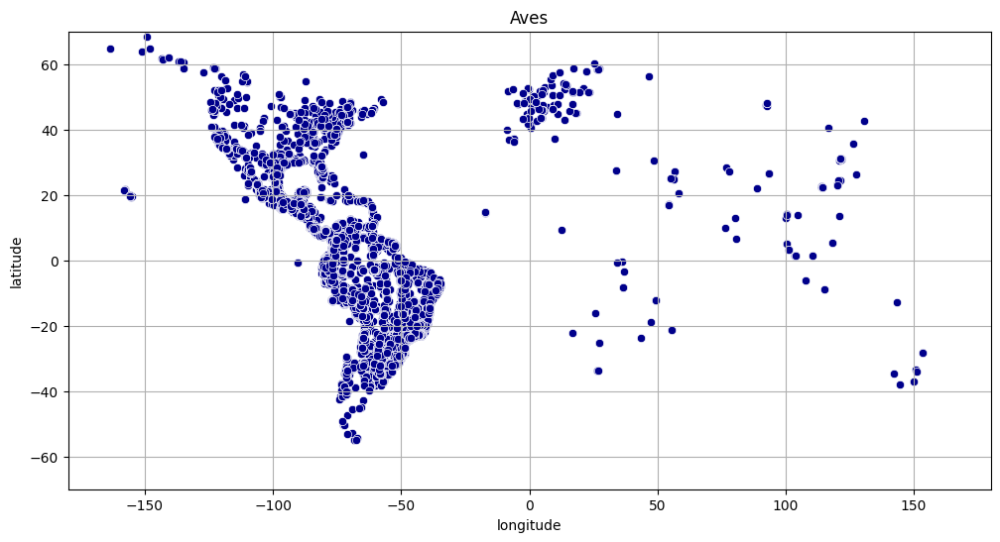

In [18]:
for specie in species:
    df_select = df[df['class_name'] == specie]

    plt.figure(figsize=(12,6))
    sns.scatterplot(data=df_select, x='longitude', y='latitude', 
                color='darkblue')
    plt.xlim(-180,180)
    plt.ylim(-70,70)
    plt.title(specie)
    plt.grid()
    plt.show()

### Vẽ bản đồ phân bố cho từng loại chim, dễ nhìn hơn

In [19]:
bird = 'trokin'
df_select = df[df['primary_label'].isin([bird])]
df_select.shape

(787, 15)

In [20]:
df_select = df_select.dropna(axis=0, subset=['latitude','longitude'])
df_select.shape

(772, 15)

In [21]:
zoom_factor = 1.9
my_map_1 = folium.Map(location=[0,0], zoom_start=zoom_factor)

for i in range(0,df_select.shape[0]):
    folium.Circle(
        location=[df_select.iloc[i]['latitude'], df_select.iloc[i]['longitude']],
        radius=np.sqrt(df_select.iloc[i]['rating'])*25000,
        color='blue',
        weight=1,
        popup='label: ' + df_select.iloc[i]['primary_label'] + '<br>' +
              'sec_labels: ' + df_select.iloc[i]['secondary_labels'] + '<br>' +
              'type: ' + df_select.iloc[i]['type'] + '<br>',
        fill=True,
        fill_color='blue').add_to(my_map_1)

my_map_1 # display

### Biểu đồ phân cụm dữ liệu thu thập 

In [22]:
data = df_train.dropna(subset=['latitude', 'longitude'])
# Create a map centered around the mean of the data
m = folium.Map(location=[data['latitude'].mean(), data['longitude'].mean()], zoom_start=4)

# Convert DataFrame to a list of (lat, lon) tuples
locations = list(zip(data.latitude, data.longitude))

# Add FastMarkerCluster to the map
FastMarkerCluster(locations).add_to(m)

# Display the map (work
m

In [23]:
# View per animal
data = df_train.dropna(subset=['latitude', 'longitude'])
def animal_map_gui():
    animal_map_select = widgets.Select(
        options=df_taxonomy['common_name'].unique(),
        description='Animals:',
        rows=10
    )
    map_output = widgets.Output()
    display(animal_map_select)
    def on_change(change):
        map_output.clear_output()
        with map_output:
            animal_id = df_taxonomy[df_taxonomy['common_name']==animal_map_select.value]['primary_label'].iloc[0]
            print(f'Name: {animal_map_select.value}')
            print(f'ID: {animal_id}')
            filtered_data = data[data['primary_label']==animal_id]
            print(f'Total Recordings: {len(filtered_data)}')
            m = folium.Map(location=[filtered_data['latitude'].mean(), filtered_data['longitude'].mean()], zoom_start=3)
            
            # Convert DataFrame to a list of (lat, lon) tuples
            locations = list(zip(filtered_data.latitude, filtered_data.longitude))
            FastMarkerCluster(locations).add_to(m)
            display(m)
    animal_map_select.observe(on_change, names='value')
    display(map_output)
            
animal_map_gui()

Select(description='Animals:', options=('Ragoniella pulchella', 'Oxyprora surinamensis', 'Copiphora colombiae'…

Output()

## 1.3 Audio Analysis

In [24]:
directory = "../input/birdclef-2025/train_audio"

folders_list = [f for f in os.listdir(directory) if os.path.isdir(os.path.join(directory, f))]
primary_label_to_name = dict(zip(df_taxonomy['primary_label'], df_taxonomy['common_name']))
name_to_primary_label = dict(zip(df_taxonomy['common_name'], df_taxonomy['primary_label']))

def audio_gui():
    # Create widgets
    animal_select = widgets.Select(
        options=sorted([primary_label_to_name.get(item, item) for item in folders_list]),
        description='Animals:',
        rows=10
    )
    
    audio_select = widgets.Select(
        options=[],
        description='Audio:',
        rows=10
    )

    audio_output = widgets.Output()

    # Function to update audio list when an animal is selected
    def on_animal_change(change):
        audio_output.clear_output()
        selected_animal = animal_select.value
        if selected_animal:
            folder_name = name_to_primary_label[selected_animal]
            audio_list = [f for f in os.listdir(os.path.join(directory, folder_name)) if f.endswith('.ogg')]
            audio_select.options = sorted(audio_list)  # Update the dropdown options

    # Function to play selected audio
    def on_audio_change(change):
        audio_output.clear_output()
        selected_animal = animal_select.value
        selected_audio = audio_select.value
        if selected_animal and selected_audio:
            audio_path = os.path.join(directory, name_to_primary_label[selected_animal], selected_audio)
            with audio_output:
                display(IPython.display.Audio(audio_path))
                y, sr = librosa.load(audio_path, sr=None)  # Load with original sample rate
                
                # Compute the spectrogram (Short-Time Fourier Transform)
                D = librosa.stft(y)
                DB = librosa.amplitude_to_db(np.abs(D), ref=np.max)  # Convert amplitude to dB
                
                # Plot the spectrogram
                plt.figure(figsize=(20, 8))
                librosa.display.specshow(DB, sr=sr, x_axis='time', y_axis='log')
                plt.colorbar(label='dB')
                plt.title(f'Spectrogram of {animal_select.value} - {audio_select.value}')
                plt.xlabel('Time (s)')
                plt.ylabel('Frequency (Hz)')
                plt.show()

    # Attach event listeners
    animal_select.observe(on_animal_change, names='value')
    audio_select.observe(on_audio_change, names='value')

    # Display widgets
    display(animal_select, audio_select, audio_output)

# Run the function
audio_gui()

Select(description='Animals:', options=('Amazon Kingfisher', 'American Kestrel', 'American Pygmy Kingfisher', …

Select(description='Audio:', options=(), rows=10, value=None)

Output()

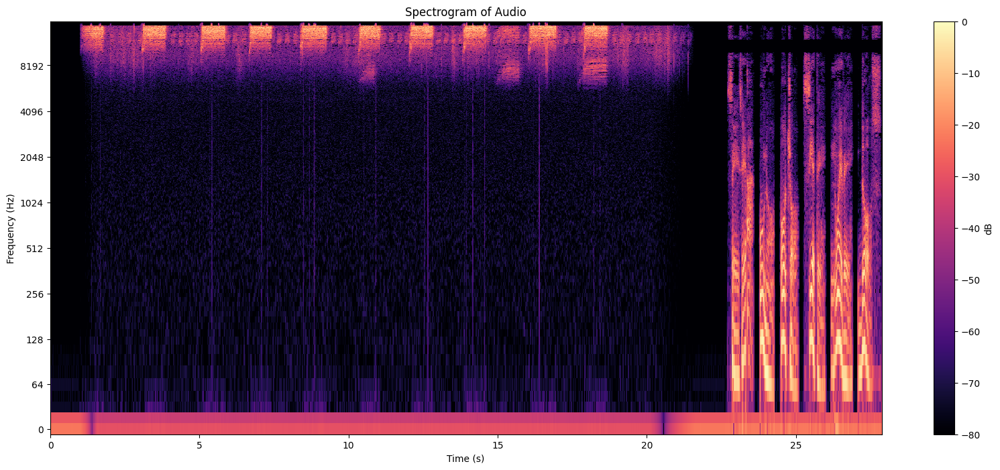

In [25]:
audio_path = "/kaggle/input/birdclef-2025/train_audio/1346504/CSA18792.ogg"
display(IPython.display.Audio(audio_path))
y, sr = librosa.load(audio_path, sr=None)
D = librosa.stft(y)
DB = librosa.amplitude_to_db(np.abs(D), ref=np.max)  # Convert amplitude to dB
                
                # Plot the spectrogram
plt.figure(figsize=(20, 8))
librosa.display.specshow(DB, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(label='dB')
plt.title(f'Spectrogram of Audio')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.show()

892138
(128, 1743)


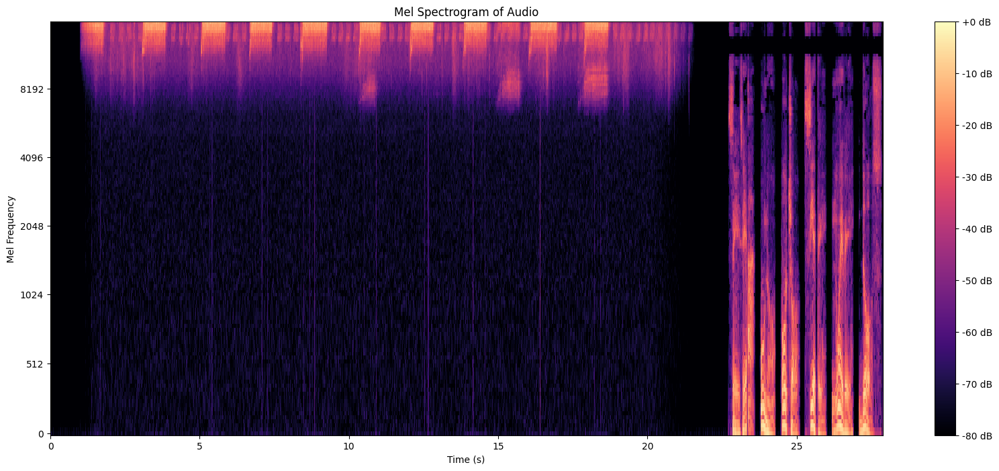

In [26]:
audio_path = "/kaggle/input/birdclef-2025/train_audio/1346504/CSA18792.ogg"

# Phát audio
display(IPython.display.Audio(audio_path))

# Load audio
y, sr = librosa.load(audio_path, sr=None)
print(len(y))

# Tính Mel Spectrogram
S = librosa.feature.melspectrogram(y=y,sr=sr,
        n_fft=cfg.N_FFT, # kích thước FFT window (độ phân giải tần số).
        hop_length=cfg.HOP_LENGTH,
        n_mels=cfg.N_MELS, # Số lượng filter mel (sau này có thể thay đổi nhiều)
        fmin=cfg.FMIN,
        fmax=cfg.FMAX,
        power=2.0) # Tính toán dựa trên công suất)

# Chuyển về dB để dễ trực quan hóa
S_DB = librosa.power_to_db(S, ref=np.max)
print(S_DB.shape)
# Vẽ Mel Spectrogram
plt.figure(figsize=(20, 8))
librosa.display.specshow(S_DB, sr=sr, x_axis='time', y_axis='mel', fmax=sr/2)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram of Audio')
plt.xlabel('Time (s)')
plt.ylabel('Mel Frequency')
plt.show()

# 2. Data Process

## 2.1 Data with human voice

### Sau khi kiểm tra một số file nghe và nhận thấy chúng có tiếng người
=> Phần lớn những file này thuộc tập dữ liệu CSA

In [27]:
## Kiểm tra số file nghe thuộc về class CSA
len(df[df['collection'] == 'CSA']) # 162 => Cũng nhiều vl

162

### Tại sao không bỏ hết các file CSA ?
Có những class chỉ có file CSA, bỏ thì thành chim cút

In [28]:
# Không phải tất cả file CSA đều có tiếng người, chỉ là phỏng đoán
# Kiểm tra xem những file CSA này thuộc về ai, thường mỗi cá nhân có một kiểu thu âm đặc trưng, 
# nếu một file có tiếng người thì khả năng các file còn lại cũng thế
df[df['collection'] == 'CSA']['author'].value_counts()

author
Diego A. Gomez-Morales                         32
Fabio A. Sarria-S                              26
Fernando Montealegre-Z                         24
Angela M. Mendoza-Henao                        19
Orlando Acevedo-Charry                         17
Mauricio Álvarez-Rebolledo                      7
Eliana Barona-Cortés                            5
Diego A Gómez-Morales                           5
Alexandra Buitrago-Cardona                      5
Eliana Barona- Cortés                           4
Ana María Ospina-Larrea                         4
Mateo Hernandez                                 2
J. Sebastian Giraldo-Bernal                     2
Ana María Ospina-Larrea | Daniela Murillo       2
Alexandra Butrago-Cardona                       2
Johann Stephens Cardenas-Bautista               1
Alejandro Mendoza | Mónica Izquierdo            1
Paula Caycedo-Rosales                           1
Eliana Barona-Cortés | Daniela García-Cobos     1
Gustavo Bravo Mora                         

### Đi nghiên cứu các file CSA có tiếng người

In [29]:
### Lấy thử data của một người
fabio = df[df['author'] == 'Fabio A. Sarria-S']
fabio

,primary_label,secondary_labels,type,filename,collection,rating,url,latitude,longitude,scientific_name,common_name,author,license,inat_taxon_id,class_name
0,1139490,[''],[''],1139490/CSA36385.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3206,-73.7128,Ragoniella pulchella,Ragoniella pulchella,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1139490,Insecta
1,1139490,[''],[''],1139490/CSA36389.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3206,-73.7128,Ragoniella pulchella,Ragoniella pulchella,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1139490,Insecta
2,1192948,[''],[''],1192948/CSA36358.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1192948,Insecta
3,1192948,[''],[''],1192948/CSA36366.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.2800,-73.8582,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1192948,Insecta
4,1192948,[''],[''],1192948/CSA36373.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1192948,Insecta
5,1192948,[''],[''],1192948/CSA36388.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1192948,Insecta
34,1462711,[''],[''],1462711/CSA36371.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.2625,-73.8207,Cocconotus aratifrons,Cocconotus aratifrons,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1462711,Insecta
35,1462711,[''],[''],1462711/CSA36379.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3842,-73.8456,Cocconotus aratifrons,Cocconotus aratifrons,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1462711,Insecta
36,1462711,[''],[''],1462711/CSA36390.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3842,-73.8456,Cocconotus aratifrons,Cocconotus aratifrons,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1462711,Insecta
37,1462737,[''],[''],1462737/CSA36341.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3200,-73.7069,Docidocercus fasciatus,Docidocercus fasciatus,Fabio A. Sarria-S,cc-by-nc-sa 4.0,1462737,Insecta


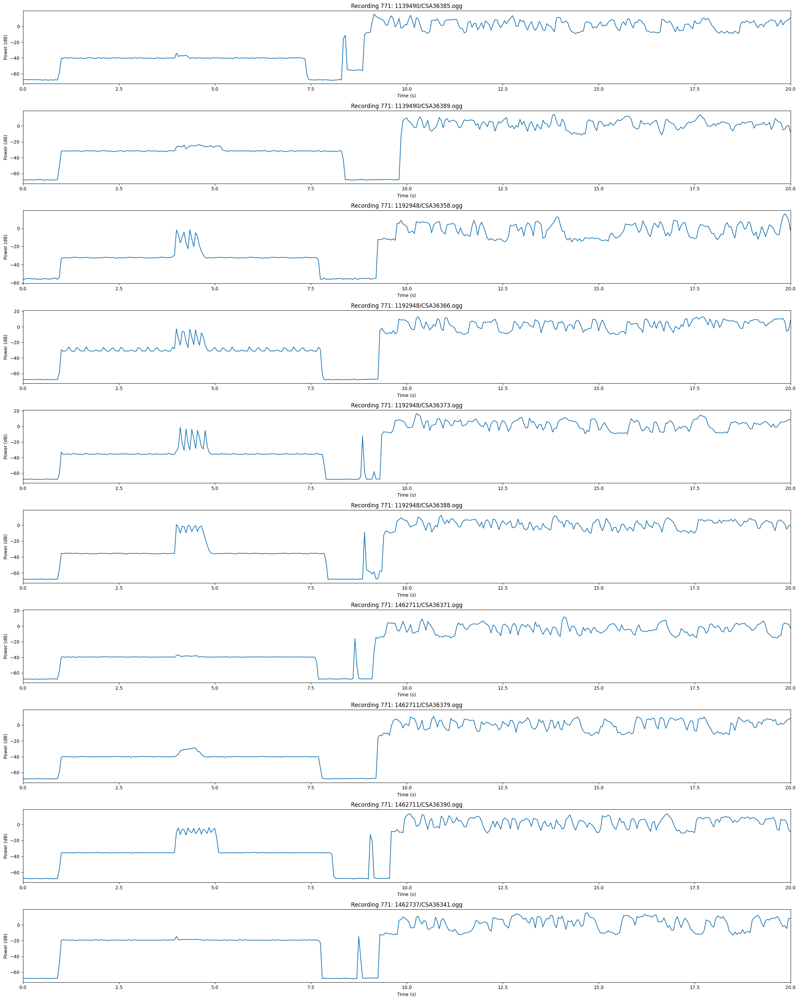

In [30]:
N = 10
chunk_len = 0.05 # Chunk len in seconds

fig, ax = plt.subplots(nrows=N)
fig.set_size_inches((24, 3 * N))
for n in range(N):
    # Load the data
    rec = fabio.iloc[n]
    wav, sr = librosa.load(f'/kaggle/input/birdclef-2025/train_audio/{rec.filename}')

    # Calculate the sound power
    power = wav ** 2
    
    # Split the data into chunks and sum the energy in every chunk
    chunk = int(chunk_len * sr)
    
    pad = int(np.ceil(len(power) / chunk) * chunk - len(power))
    power = np.pad(power, (0, pad))
    power = power.reshape((-1, chunk)).sum(axis=1)

    t = np.arange(len(power)) * chunk_len
    ax[n].plot(t, 10 * np.log10(power))
    ax[n].set_xlim([0, 20])
    ax[n].set_title(f'Recording {i}: {rec.filename}')
    ax[n].set_xlabel('Time (s)')
    ax[n].set_ylabel('Power (dB)')

    display(IPython.display.Audio(f'/kaggle/input/birdclef-2025/train_audio/{rec.filename}'))

plt.tight_layout()
plt.show()

### Nhận xét
- Khi có tiếng người nói, năng lượng ở các chunk tăng cao
=> Có thể dựa vào đây để xác định phạm vi tiếng người
- Thời điểm đầu là thời điểm có tiếng chim hót, chỉ >-50db và < 0db, có thể dựa vào đây để cắt âm thanh.

In [31]:
# Tiến hành cắt âm thanh 
level = -50
N = 1
result = fabio['filename'].to_frame()

for n, rec in fabio.iterrows():
    # Load the data
    wav, sr = librosa.load(f'/kaggle/input/birdclef-2025/train_audio/{rec.filename}')

    # Calculate the sound power
    power = wav ** 2
    
    # Split the data into chunks and sum the energy in every chunk
    chunk = int(chunk_len * sr)
    
    pad = int(np.ceil(len(power) / chunk) * chunk - len(power))
    power = np.pad(power, (0, pad))
    power = power.reshape((-1, chunk)).sum(axis=1)

    power_dB = 10 * np.log10(power)
    x = power_dB - level
    intersections = np.where(x[:-1] * x[1:] < 0)[0] # So sánh thời gian t và t + 1, nếu nó âm chứng tỏ có sự thay đổi âm thanh
    a, b = intersections[:2]
    result.loc[result['filename'] == rec.filename, 'start'] = a * chunk_len
    result.loc[result['filename'] == rec.filename, 'stop'] = b * chunk_len

In [32]:
result.to_csv('fabio.csv', index=False)
display(result)

,filename,start,stop
0,1139490/CSA36385.ogg,0.95,7.35
1,1139490/CSA36389.ogg,0.95,8.35
2,1192948/CSA36358.ogg,0.95,7.70
3,1192948/CSA36366.ogg,0.95,7.75
4,1192948/CSA36373.ogg,0.95,7.85
5,1192948/CSA36388.ogg,0.95,7.90
34,1462711/CSA36371.ogg,0.95,7.65
35,1462711/CSA36379.ogg,0.95,7.70
36,1462711/CSA36390.ogg,0.95,8.05
37,1462737/CSA36341.ogg,0.90,7.75


### Model mới
Để chắc chắn cắt đúng được tiếng người ra khỏi file nghe, sử dụng thêm **VAD** (Voice Activity Detection) - một mô hình nhận diện giọng nói của con người đã được pretrain và có sẵn trong torchhub
(https://github.com/snakers4/silero-vad)

In [33]:
torch.set_num_threads(1)

model, utils = torch.hub.load(repo_or_dir='snakers4/silero-vad', model='silero_vad',  trust_repo=True)
(get_speech_timestamps, _, read_audio, _, _) = utils

Downloading: "https://github.com/snakers4/silero-vad/zipball/master" to /root/.cache/torch/hub/master.zip


In [34]:
df = pd.read_csv('/kaggle/input/birdclef-2025/train.csv')
df = df[df.collection == 'CSA'].copy()

author_map = {
    'Paula Caycedo-Rosales | Juan-Pablo López': 'Paula Caycedo-Rosales',
    'Ana María Ospina-Larrea | Daniela Murillo': 'Ana María Ospina-Larrea',
    'Eliana Barona-Cortés | Daniela García-Cobos': 'Eliana Barona-Cortés',
    'Eliana Barona- Cortés': 'Eliana Barona-Cortés',
    'Alexandra Butrago-Cardona': 'Alexandra Buitrago-Cardona',
    'Diego A Gómez-Morales': 'Diego A. Gomez-Morales',
}
author_map_func = lambda x: author_map[x] if x in author_map.keys() else x

df.author = df.author.map(author_map_func)
authors = sorted(df['author'].unique())

We have 1 recordings by Alejandro Mendoza | Mónica Izquierdo in total


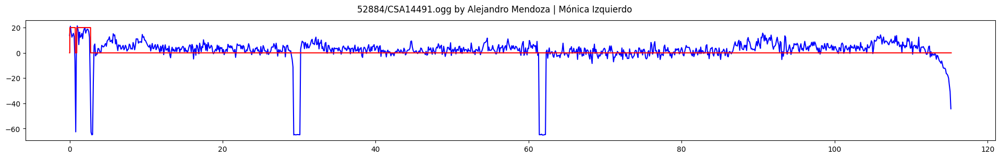

We have 7 recordings by Alexandra Buitrago-Cardona in total


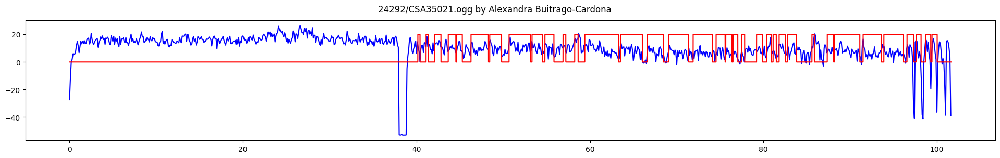

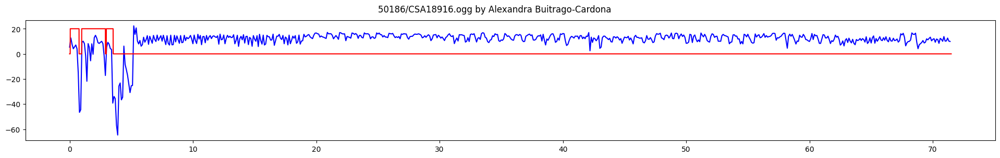

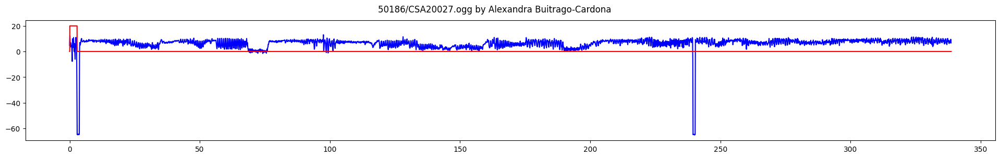

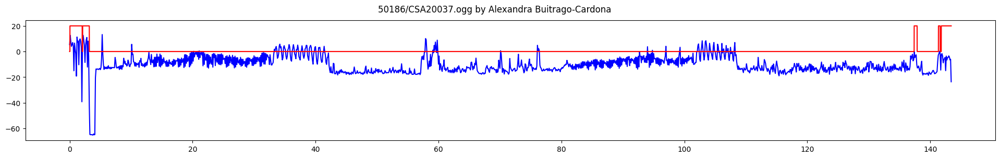

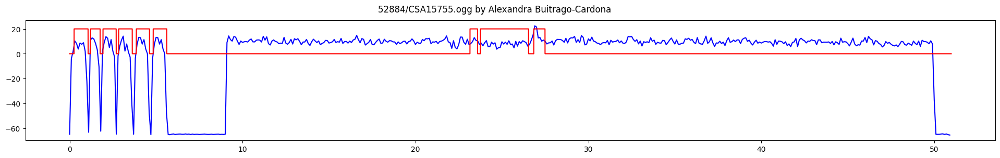

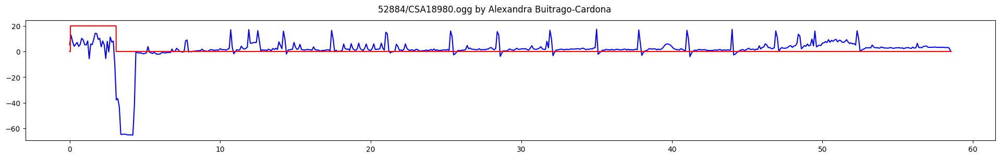

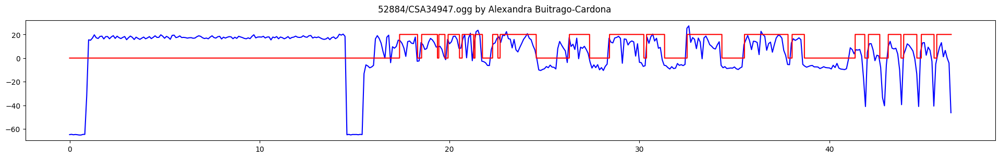

We have 6 recordings by Ana María Ospina-Larrea in total


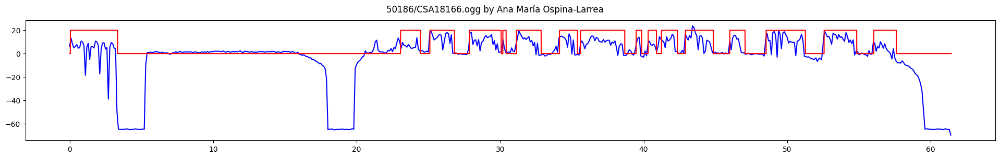

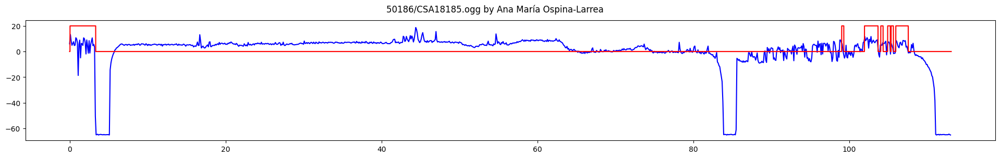

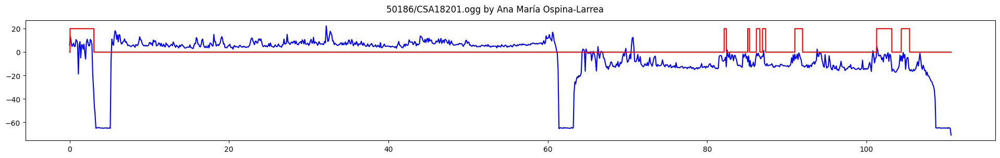

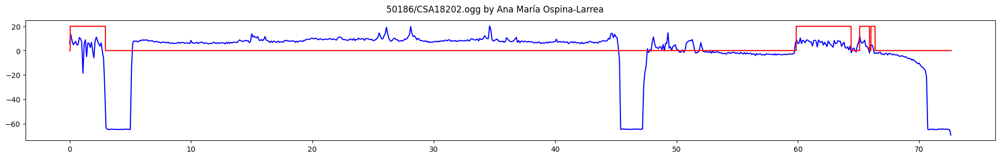

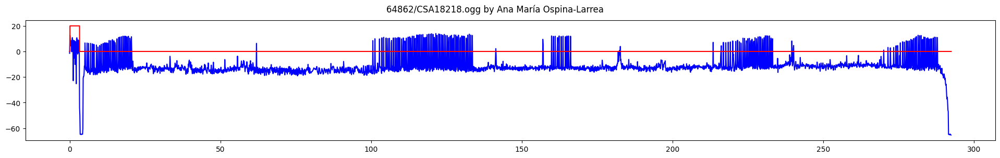

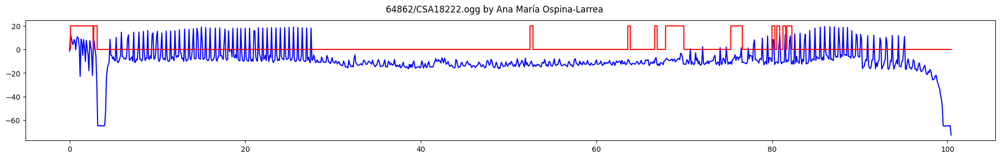

In [35]:
for author in authors[:3]:
    selection = df[df.author == author].copy()
    print(f'We have {len(selection)} recordings by {author} in total')
    
    N = len(selection)
    chunk_len = 0.1 # Chunk len in seconds
    
    for n in range(N):
        # Load the data
        rec = selection.iloc[n]
        fname = f'/kaggle/input/birdclef-2025/train_audio/{rec.filename}'
        wav, sr = librosa.load(fname)
    
        # Calculate the sound power
        power = wav ** 2
        
        # Split the data into chunks and sum the energy in every chunk
        chunk = int(chunk_len * sr)
        
        pad = int(np.ceil(len(power) / chunk) * chunk - len(power))
        power = np.pad(power, (0, pad))
        power = power.reshape((-1, chunk)).sum(axis=1)

        # Xác định tiếng nói có trong ogg
        speech_timestamps = get_speech_timestamps(torch.Tensor(wav), model)
        segmentation = np.zeros_like(wav)
        for st in speech_timestamps:
            segmentation[st['start']: st['end']] = 20
    
        fig = plt.figure(figsize=(24, 3))
        fig.suptitle(f'{rec.filename} by {rec.author}')
        
        t = np.arange(len(power)) * chunk_len
        plt.plot(t, 10 * np.log10(power), 'b')
        
        t = np.arange(len(segmentation)) / sr
        plt.plot(t, segmentation, 'r')        
        plt.show()
        
        display(IPython.display.Audio(fname))

### Nhận xét
Có thể thầy là pattern của các file âm thanh rất khác nhau, lúc thì người nói đầu, lúc thì người nói cuối, vậy nên suggest sử dụng VAD để tìm chính xác vị trí có tiếng người và bỏ đi

### Note
Bên trong các file train có tiếng người, cần bỏ đi là hiển nhiên. Tuy nhiên, theo một số disscusion, bên trong train_soundscape cũng có tiêng người, và thậm chí có thể trong test_soundscape cũng vậy [discussion](https://www.kaggle.com/competitions/birdclef-2025/discussion/568886#3154723).
=> Cần quyết định có bỏ tiếng người trong file train_soundscape hay không, cái này sẽ được chứng minh qua public score.

In [36]:
## Tiến hành xác định tiếng người có trong các file audio_train và ghi vào pkl
# files = sorted(glob('/kaggle/input/birdclef-2025/train_audio/*/*.ogg'))
# voice_data = {}
# for fname in files:
#     wav = read_audio(fname)
#     speech_timestamps = get_speech_timestamps(wav, model, return_seconds=True, threshold=0.4) # Chọn 0.4 để nó nhận diện tiếng nói tốt hơn
#     if len(speech_timestamps):
#         voice_data[fname] = speech_timestamps

#         with open('train_voice_summary.txt', 'a') as f:
#             f.write(f'{fname}\n')
            
# with open('train_voice_data.pkl', 'wb') as f:
#     pickle.dump(voice_data, f)

In [37]:
# files = sorted(glob('/kaggle/input/birdclef-2025/train_soundscapes/*.ogg'))
# voice_data = {}
# for fname in files:
#     wav = read_audio(fname)
#     speech_timestamps = get_speech_timestamps(wav, model, return_seconds=True, threshold=0.5) # default threshold
#     if len(speech_timestamps):
#         voice_data[fname] = speech_timestamps

#         with open('ss_voice_summary.txt', 'a') as f:
#             f.write(f'{fname}\n')
            
# with open('ss_voice_data.pkl', 'wb') as f:
#     pickle.dump(voice_data, f)

### Phần này rất nặng nên chuyển qua sử dụng các file pkl

## 2.2 Các hàm xử lý audio

In [38]:
def audio2melspec(audio_data, cfg):
    """Convert audio data to mel spectrogram"""
    if np.isnan(audio_data).any():
        mean_signal = np.nanmean(audio_data)
        audio_data = np.nan_to_num(audio_data, nan=mean_signal) # Thay thế nan trong dữ liệu bằng mean

    mel_spec = librosa.feature.melspectrogram(
        y=audio_data,
        sr=cfg.FS,
        n_fft=cfg.N_FFT, # kích thước FFT window (độ phân giải tần số).
        hop_length=cfg.HOP_LENGTH,
        n_mels=cfg.N_MELS, # Số lượng filter mel (sau này có thể thay đổi nhiều)
        fmin=cfg.FMIN,
        fmax=cfg.FMAX,
        power=2.0 # Tính toán dựa trên công suất
    )

    mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)
    mel_spec_norm = (mel_spec_db - mel_spec_db.min()) / (mel_spec_db.max() - mel_spec_db.min() + 1e-8) # Chuẩn hóa để thuận tiện cho mô hình học
    
    return mel_spec_norm

In [39]:
def process_audio_file(audio_path, cfg):
    """ Get mel spectrogram"""
    try:
        audio_data, _ = librosa.load(audio_path, sr=cfg.FS)

        target_samples = int(cfg.TARGET_DURATION * cfg.FS)

        if len(audio_data) < target_samples:
            n_copy = math.ceil(target_samples / len(audio_data))

            if n_copy > 1:
                audio_data = np.concatenate([audio_data] * n_copy)

        # Lấy 5s giữa
        start_idx = max(0, int(len(audio_data) / 2 - target_samples / 2))
        end_idx = min(len(audio_data), start_idx + target_samples)

        center_audio = audio_data[start_idx:end_idx]

        # Tạo padding = 0 nếu như không có đủ sample (Các âm im)
        if len(center_audio) < target_samples:
            center_audio = np.pad(center_audio, 
                                 (0, target_samples - len(center_audio)), 
                                 mode='constant')

        mel_spec = audio2melspec(center_audio, cfg)
        if mel_spec.shape != cfg.TARGET_SHAPE:
            mel_spec = cv2.resize(mel_spec, cfg.TARGET_SHAPE, interpolation=cv2.INTER_LINEAR)

        return mel_spec.astype(np.float32)
    except Exception as e:
        print(f"Error processing {audio_path}: {e}")
        return None

In [40]:
def generate_spectrograms(df, cfg):
    """Generate spectrograms from audio files"""
    start_time = time.time()

    all_bird_data = {}
    errors = []

    for i, row in tqdm(df.iterrows(), total=len(df)):
        if cfg.debug and i >= 1000:
            break
        try:
            samplename = row['samplename']
            filepath = row['filepath']
            
            mel_spec = process_audio_file(filepath, cfg)
            
            if mel_spec is not None:
                all_bird_data[samplename] = mel_spec
            
        except Exception as e:
            print(f"Error processing {row.filepath}: {e}")
            errors.append((row.filepath, str(e)))
    end_time = time.time()
    print(f"Processing completed in {end_time - start_time:.2f} seconds")
    print(f"Successfully processed {len(all_bird_data)} files out of {len(df)}")
    print(f"Failed to process {len(errors)} files")
    
    return all_bird_data

## 2.3 Dataset

In [41]:
class BirdCLEFDataset(Dataset):
    def __init__(self, df, cfg, spectrograms=None, mode="train"):
        self.df = df
        self.cfg = cfg
        self.mode = mode

        self.spectrograms = spectrograms
        
        taxonomy_df = pd.read_csv(self.cfg.taxonomy_csv)
        self.species_ids = taxonomy_df['primary_label'].tolist()
        self.num_classes = len(self.species_ids)
        self.label_to_idx = {label: idx for idx, label in enumerate(self.species_ids)}

        if 'filepath' not in self.df.columns:
            self.df['filepath'] = self.cfg.train_datadir + '/' + self.df.filename
        
        if 'samplename' not in self.df.columns:
            self.df['samplename'] = self.df.filename.map(lambda x: x.split('/')[0] + '-' + x.split('/')[-1].split('.')[0])

        sample_names = set(self.df['samplename'])
        if self.spectrograms:
            found_samples = sum(1 for name in sample_names if name in self.spectrograms)
            print(f"Found {found_samples} matching spectrograms for {mode} dataset out of {len(self.df)} samples")
        
        if cfg.debug:
            self.df = self.df.sample(min(1000, len(self.df)), random_state=cfg.seed).reset_index(drop=True)
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        samplename = row['samplename']
        spec = None

        if self.spectrograms and samplename in self.spectrograms:
            spec = self.spectrograms[samplename]
        elif not self.cfg.LOAD_DATA:
            spec = process_audio_file(row['filepath'], self.cfg)

        if spec is None:
            spec = np.zeros(self.cfg.TARGET_SHAPE, dtype=np.float32)
            if self.mode == "train":  # Only print warning during training
                print(f"Warning: Spectrogram for {samplename} not found and could not be generated")

        spec = torch.tensor(spec, dtype=torch.float32).unsqueeze(0)  # Add channel dimension

        if self.mode == "train" and random.random() < self.cfg.aug_prob:
            spec = self.apply_spec_augmentations(spec)
        
        target = self.encode_label(row['primary_label'])
        
        if 'secondary_labels' in row and row['secondary_labels'] not in [[''], None, np.nan]:
            if isinstance(row['secondary_labels'], str):
                secondary_labels = eval(row['secondary_labels'])
            else:
                secondary_labels = row['secondary_labels']
            
            for label in secondary_labels:
                if label in self.label_to_idx:
                    target[self.label_to_idx[label]] = 1.0
        
        return {
            'melspec': spec, 
            'target': torch.tensor(target, dtype=torch.float32),
            'filename': row['filename']
        }
    
    def apply_spec_augmentations(self, spec):
        """Apply augmentations to spectrogram"""
    
        # Time masking (horizontal stripes)
        if random.random() < 0.5:
            num_masks = random.randint(1, 3)
            for _ in range(num_masks):
                width = random.randint(5, 20)
                start = random.randint(0, spec.shape[2] - width)
                spec[0, :, start:start+width] = 0
        
        # Frequency masking (vertical stripes)
        if random.random() < 0.5:
            num_masks = random.randint(1, 3)
            for _ in range(num_masks):
                height = random.randint(5, 20)
                start = random.randint(0, spec.shape[1] - height)
                spec[0, start:start+height, :] = 0
        
        # Random brightness/contrast
        if random.random() < 0.5:
            gain = random.uniform(0.8, 1.2)
            bias = random.uniform(-0.1, 0.1)
            spec = spec * gain + bias
            spec = torch.clamp(spec, 0, 1) 
            
        return spec
    
    def encode_label(self, label):
        """Encode label to one-hot vector"""
        target = np.zeros(self.num_classes)
        if label in self.label_to_idx:
            target[self.label_to_idx[label]] = 1.0
        return target

In [42]:
def collate_fn(batch):
    """Custom collate function to handle different sized spectrograms"""
    batch = [item for item in batch if item is not None]
    if len(batch) == 0:
        return {}
        
    result = {key: [] for key in batch[0].keys()}
    
    for item in batch:
        for key, value in item.items():
            result[key].append(value)
    
    for key in result:
        if key == 'target' and isinstance(result[key][0], torch.Tensor):
            result[key] = torch.stack(result[key])
        elif key == 'melspec' and isinstance(result[key][0], torch.Tensor):
            shapes = [t.shape for t in result[key]]
            if len(set(str(s) for s in shapes)) == 1:
                result[key] = torch.stack(result[key])
    
    return result

In [43]:
class BirdCLEFModel(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.cfg = cfg
        
        taxonomy_df = pd.read_csv(cfg.taxonomy_csv)
        cfg.num_classes = len(taxonomy_df)
        
        self.backbone = timm.create_model(
            cfg.model_name,
            pretrained=cfg.pretrained,
            in_chans=cfg.in_channels,
            drop_rate=0.2,
            drop_path_rate=0.2
        )
        
        if 'efficientnet' in cfg.model_name:
            backbone_out = self.backbone.classifier.in_features
            self.backbone.classifier = nn.Identity()
        elif 'resnet' in cfg.model_name:
            backbone_out = self.backbone.fc.in_features
            self.backbone.fc = nn.Identity()
        else:
            backbone_out = self.backbone.get_classifier().in_features
            self.backbone.reset_classifier(0, '')
        
        self.pooling = nn.AdaptiveAvgPool2d(1)
            
        self.feat_dim = backbone_out
        
        self.classifier = nn.Linear(backbone_out, cfg.num_classes)
        
        self.mixup_enabled = hasattr(cfg, 'mixup_alpha') and cfg.mixup_alpha > 0
        if self.mixup_enabled:
            self.mixup_alpha = cfg.mixup_alpha
            
    def forward(self, x, targets=None):
    
        if self.training and self.mixup_enabled and targets is not None:
            mixed_x, targets_a, targets_b, lam = self.mixup_data(x, targets)
            x = mixed_x
        else:
            targets_a, targets_b, lam = None, None, None
        
        features = self.backbone(x)
        
        if isinstance(features, dict):
            features = features['features']
            
        if len(features.shape) == 4:
            features = self.pooling(features)
            features = features.view(features.size(0), -1)
        
        logits = self.classifier(features)
        
        if self.training and self.mixup_enabled and targets is not None:
            loss = self.mixup_criterion(F.binary_cross_entropy_with_logits, 
                                       logits, targets_a, targets_b, lam)
            return logits, loss
            
        return logits
    
    def mixup_data(self, x, targets):
        """Applies mixup to the data batch"""
        batch_size = x.size(0)

        lam = np.random.beta(self.mixup_alpha, self.mixup_alpha)

        indices = torch.randperm(batch_size).to(x.device)

        mixed_x = lam * x + (1 - lam) * x[indices]
        
        return mixed_x, targets, targets[indices], lam
    
    def mixup_criterion(self, criterion, pred, y_a, y_b, lam):
        """Applies mixup to the loss function"""
        return lam * criterion(pred, y_a) + (1 - lam) * criterion(pred, y_b)

In [44]:
def get_optimizer(model, cfg):
  
    if cfg.optimizer == 'Adam':
        optimizer = optim.Adam(
            model.parameters(),
            lr=cfg.lr,
            weight_decay=cfg.weight_decay
        )
    elif cfg.optimizer == 'AdamW':
        optimizer = optim.AdamW(
            model.parameters(),
            lr=cfg.lr,
            weight_decay=cfg.weight_decay
        )
    elif cfg.optimizer == 'SGD':
        optimizer = optim.SGD(
            model.parameters(),
            lr=cfg.lr,
            momentum=0.9,
            weight_decay=cfg.weight_decay
        )
    else:
        raise NotImplementedError(f"Optimizer {cfg.optimizer} not implemented")
        
    return optimizer

def get_scheduler(optimizer, cfg):
   
    if cfg.scheduler == 'CosineAnnealingLR':
        scheduler = lr_scheduler.CosineAnnealingLR(
            optimizer,
            T_max=cfg.T_max,
            eta_min=cfg.min_lr
        )
    elif cfg.scheduler == 'ReduceLROnPlateau':
        scheduler = lr_scheduler.ReduceLROnPlateau(
            optimizer,
            mode='min',
            factor=0.5,
            patience=2,
            min_lr=cfg.min_lr,
            verbose=True
        )
    elif cfg.scheduler == 'StepLR':
        scheduler = lr_scheduler.StepLR(
            optimizer,
            step_size=cfg.epochs // 3,
            gamma=0.5
        )
    elif cfg.scheduler == 'OneCycleLR':
        scheduler = None  
    else:
        scheduler = None
        
    return scheduler

def get_criterion(cfg):
 
    if cfg.criterion == 'BCEWithLogitsLoss':
        criterion = nn.BCEWithLogitsLoss()
    else:
        raise NotImplementedError(f"Criterion {cfg.criterion} not implemented")
        
    return criterion

In [45]:
def train_one_epoch(model, loader, optimizer, criterion, device, scheduler=None):
    
    model.train()
    losses = []
    all_targets = []
    all_outputs = []
    
    pbar = tqdm(enumerate(loader), total=len(loader), desc="Training")
    
    for step, batch in pbar:
    
        if isinstance(batch['melspec'], list):
            batch_outputs = []
            batch_losses = []
            
            for i in range(len(batch['melspec'])):
                inputs = batch['melspec'][i].unsqueeze(0).to(device)
                target = batch['target'][i].unsqueeze(0).to(device)
                
                optimizer.zero_grad()
                output = model(inputs)
                loss = criterion(output, target)
                loss.backward()
                
                batch_outputs.append(output.detach().cpu())
                batch_losses.append(loss.item())
            
            optimizer.step()
            outputs = torch.cat(batch_outputs, dim=0).numpy()
            loss = np.mean(batch_losses)
            targets = batch['target'].numpy()
            
        else:
            inputs = batch['melspec'].to(device)
            targets = batch['target'].to(device)
            
            optimizer.zero_grad()
            outputs = model(inputs)
            
            if isinstance(outputs, tuple):
                outputs, loss = outputs  
            else:
                loss = criterion(outputs, targets)
                
            loss.backward()
            optimizer.step()
            
            outputs = outputs.detach().cpu().numpy()
            targets = targets.detach().cpu().numpy()
        
        if scheduler is not None and isinstance(scheduler, lr_scheduler.OneCycleLR):
            scheduler.step()
            
        all_outputs.append(outputs)
        all_targets.append(targets)
        losses.append(loss if isinstance(loss, float) else loss.item())
        
        pbar.set_postfix({
            'train_loss': np.mean(losses[-10:]) if losses else 0,
            'lr': optimizer.param_groups[0]['lr']
        })
    
    all_outputs = np.concatenate(all_outputs)
    all_targets = np.concatenate(all_targets)
    auc = calculate_auc(all_targets, all_outputs)
    avg_loss = np.mean(losses)
    
    return avg_loss, auc

def validate(model, loader, criterion, device):
   
    model.eval()
    losses = []
    all_targets = []
    all_outputs = []
    
    with torch.no_grad():
        for batch in tqdm(loader, desc="Validation"):
            if isinstance(batch['melspec'], list):
                batch_outputs = []
                batch_losses = []
                
                for i in range(len(batch['melspec'])):
                    inputs = batch['melspec'][i].unsqueeze(0).to(device)
                    target = batch['target'][i].unsqueeze(0).to(device)
                    
                    output = model(inputs)
                    loss = criterion(output, target)
                    
                    batch_outputs.append(output.detach().cpu())
                    batch_losses.append(loss.item())
                
                outputs = torch.cat(batch_outputs, dim=0).numpy()
                loss = np.mean(batch_losses)
                targets = batch['target'].numpy()
                
            else:
                inputs = batch['melspec'].to(device)
                targets = batch['target'].to(device)
                
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                
                outputs = outputs.detach().cpu().numpy()
                targets = targets.detach().cpu().numpy()
            
            all_outputs.append(outputs)
            all_targets.append(targets)
            losses.append(loss if isinstance(loss, float) else loss.item())
    
    all_outputs = np.concatenate(all_outputs)
    all_targets = np.concatenate(all_targets)
    
    auc = calculate_auc(all_targets, all_outputs)
    avg_loss = np.mean(losses)
    
    return avg_loss, auc

def calculate_auc(targets, outputs):
  
    num_classes = targets.shape[1]
    aucs = []
    
    probs = 1 / (1 + np.exp(-outputs))
    
    for i in range(num_classes):
        
        if np.sum(targets[:, i]) > 0:
            class_auc = roc_auc_score(targets[:, i], probs[:, i])
            aucs.append(class_auc)
    
    return np.mean(aucs) if aucs else 0.0

In [46]:
def run_training(df, cfg):
    """Training function that can either use pre-computed spectrograms or generate them on-the-fly"""

    taxonomy_df = pd.read_csv(cfg.taxonomy_csv)
    species_ids = taxonomy_df['primary_label'].tolist()
    cfg.num_classes = len(species_ids)
    
    if cfg.debug:
        cfg.update_debug_settings()

    spectrograms = None
    if cfg.LOAD_DATA:
        print("Loading pre-computed mel spectrograms from NPY file...")
        try:
            spectrograms = np.load(cfg.spectrogram_npy, allow_pickle=True).item()
            print(f"Loaded {len(spectrograms)} pre-computed mel spectrograms")
        except Exception as e:
            print(f"Error loading pre-computed spectrograms: {e}")
            print("Will generate spectrograms on-the-fly instead.")
            cfg.LOAD_DATA = False
    
    if not cfg.LOAD_DATA:
        print("Will generate spectrograms on-the-fly during training.")
        if 'filepath' not in df.columns:
            df['filepath'] = cfg.train_datadir + '/' + df.filename
        if 'samplename' not in df.columns:
            df['samplename'] = df.filename.map(lambda x: x.split('/')[0] + '-' + x.split('/')[-1].split('.')[0])
        
    skf = StratifiedKFold(n_splits=cfg.n_fold, shuffle=True, random_state=cfg.seed)
    
    best_scores = []
    
    for fold, (train_idx, val_idx) in enumerate(skf.split(df, df['primary_label'])):
        if fold not in cfg.selected_folds:
            continue
            
        print(f'\n{"="*30} Fold {fold} {"="*30}')
        
        train_df = df.iloc[train_idx].reset_index(drop=True)
        val_df = df.iloc[val_idx].reset_index(drop=True)
        
        print(f'Training set: {len(train_df)} samples')
        print(f'Validation set: {len(val_df)} samples')
        
        train_dataset = BirdCLEFDataset(train_df, cfg, spectrograms=spectrograms, mode='train')
        val_dataset = BirdCLEFDataset(val_df, cfg, spectrograms=spectrograms, mode='valid')
        
        train_loader = DataLoader(
            train_dataset, 
            batch_size=cfg.batch_size, 
            shuffle=True, 
            num_workers=cfg.num_workers,
            pin_memory=True,
            collate_fn=collate_fn,
            drop_last=True
        )
        
        val_loader = DataLoader(
            val_dataset, 
            batch_size=cfg.batch_size, 
            shuffle=False, 
            num_workers=cfg.num_workers,
            pin_memory=True,
            collate_fn=collate_fn
        )
        
        model = BirdCLEFModel(cfg).to(cfg.device)
        optimizer = get_optimizer(model, cfg)
        criterion = get_criterion(cfg)
        
        if cfg.scheduler == 'OneCycleLR':
            scheduler = lr_scheduler.OneCycleLR(
                optimizer,
                max_lr=cfg.lr,
                steps_per_epoch=len(train_loader),
                epochs=cfg.epochs,
                pct_start=0.1
            )
        else:
            scheduler = get_scheduler(optimizer, cfg)
        
        best_auc = 0
        best_epoch = 0
        
        for epoch in range(cfg.epochs):
            print(f"\nEpoch {epoch+1}/{cfg.epochs}")
            
            train_loss, train_auc = train_one_epoch(
                model, 
                train_loader, 
                optimizer, 
                criterion, 
                cfg.device,
                scheduler if isinstance(scheduler, lr_scheduler.OneCycleLR) else None
            )
            
            val_loss, val_auc = validate(model, val_loader, criterion, cfg.device)

            if scheduler is not None and not isinstance(scheduler, lr_scheduler.OneCycleLR):
                if isinstance(scheduler, lr_scheduler.ReduceLROnPlateau):
                    scheduler.step(val_loss)
                else:
                    scheduler.step()

            print(f"Train Loss: {train_loss:.4f}, Train AUC: {train_auc:.4f}")
            print(f"Val Loss: {val_loss:.4f}, Val AUC: {val_auc:.4f}")
            
            if val_auc > best_auc:
                best_auc = val_auc
                best_epoch = epoch + 1
                print(f"New best AUC: {best_auc:.4f} at epoch {best_epoch}")

                torch.save({
                    'model_state_dict': model.state_dict(),
                    'optimizer_state_dict': optimizer.state_dict(),
                    'scheduler_state_dict': scheduler.state_dict() if scheduler else None,
                    'epoch': epoch,
                    'val_auc': val_auc,
                    'train_auc': train_auc,
                    'cfg': cfg
                }, f"model_fold{fold}.pth")
        
        best_scores.append(best_auc)
        print(f"\nBest AUC for fold {fold}: {best_auc:.4f} at epoch {best_epoch}")
        
        # Clear memory
        del model, optimizer, scheduler, train_loader, val_loader
        torch.cuda.empty_cache()
        gc.collect()
    
    print("\n" + "="*60)
    print("Cross-Validation Results:")
    for fold, score in enumerate(best_scores):
        print(f"Fold {cfg.selected_folds[fold]}: {score:.4f}")
    print(f"Mean AUC: {np.mean(best_scores):.4f}")
    print("="*60)

In [47]:
if __name__ == "__main__":
    import time
    
    print("\nLoading training data...")
    train_df = pd.read_csv(cfg.train_csv)
    taxonomy_df = pd.read_csv(cfg.taxonomy_csv)

    print("\nStarting training...")
    print(f"LOAD_DATA is set to {cfg.LOAD_DATA}")
    if cfg.LOAD_DATA:
        print("Using pre-computed mel spectrograms from NPY file")
    else:
        print("Will generate spectrograms on-the-fly during training")
    
    run_training(train_df, cfg)
    
    print("\nTraining complete!")


Loading training data...

Starting training...
LOAD_DATA is set to True
Using pre-computed mel spectrograms from NPY file
Loading pre-computed mel spectrograms from NPY file...
Error loading pre-computed spectrograms: [Errno 2] No such file or directory: '/kaggle/input/birdclef25-mel-spectrograms/birdclef2025_melspec_5sec_256_256.npy'
Will generate spectrograms on-the-fly instead.
Will generate spectrograms on-the-fly during training.

============================== Fold 0 ==============================
Training set: 22851 samples
Validation set: 5713 samples


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


model.safetensors:   0%|          | 0.00/21.4M [00:00<?, ?B/s]


Epoch 1/2


Training:   0%|          | 0/31 [00:00<?, ?it/s]

Validation:   0%|          | 0/32 [00:00<?, ?it/s]

Train Loss: 0.1894, Train AUC: 0.4922
Val Loss: 0.0509, Val AUC: 0.5160
New best AUC: 0.5160 at epoch 1

Epoch 2/2


Training:   0%|          | 0/31 [00:00<?, ?it/s]

Validation:   0%|          | 0/32 [00:00<?, ?it/s]

Train Loss: 0.0321, Train AUC: 0.5123
Val Loss: 0.0322, Val AUC: 0.5184
New best AUC: 0.5184 at epoch 2

Best AUC for fold 0: 0.5184 at epoch 2

Cross-Validation Results:
Fold 0: 0.5184
Mean AUC: 0.5184

Training complete!
